<a href="https://colab.research.google.com/github/fedelosio99/Mioti/blob/main/Estadistica/Federico_Losio_Proyecto6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#Importing the basic librarires

import os
import math
import scipy
import numpy as np
import pandas as pd
import seaborn as sns
import datetime as dt
import geopy.distance
import time
import plotly.express as px
import plotly.graph_objects as go
import plotly.figure_factory as ff
from tqdm import tqdm
from IPython.display import display

from statsmodels.formula import api
from sklearn.feature_selection import RFE
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from statsmodels.stats.outliers_influence import variance_inflation_factor

from sklearn.decomposition import PCA
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error

import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = [10,6]

import warnings
warnings.filterwarnings('ignore')

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from geopy.geocoders import Nominatim

Entregar un notebook por persona. Debe

- Cargar datos (si es necesario adjuntar los datos)
- Hacer gráficas sobre las variables relevantes individuales. Recordar explicar los resultados
- Outliers
- Test estadísticos
- Correlaciones
- Recta de regresión con interpretación de los resultados

In [ ]:
# utilizare un Dataset de uber, que brinda informacion de la fare amount, el horario y las ubicaciones de droppoff y pickup

In [ ]:
df_raw = pd.read_csv('/content/drive/MyDrive/Master Ds/Estadistica/Trabajos/Federico Losio - proyecto 6/uber.csv')
df_raw

,Unnamed: 0,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,24238194,2015-05-07 19:52:06.0000003,7.5,2015-05-07 19:52:06 UTC,-73.999817,40.738354,-73.999512,40.723217,1
1,27835199,2009-07-17 20:04:56.0000002,7.7,2009-07-17 20:04:56 UTC,-73.994355,40.728225,-73.994710,40.750325,1
2,44984355,2009-08-24 21:45:00.00000061,12.9,2009-08-24 21:45:00 UTC,-74.005043,40.740770,-73.962565,40.772647,1
3,25894730,2009-06-26 08:22:21.0000001,5.3,2009-06-26 08:22:21 UTC,-73.976124,40.790844,-73.965316,40.803349,3
4,17610152,2014-08-28 17:47:00.000000188,16.0,2014-08-28 17:47:00 UTC,-73.925023,40.744085,-73.973082,40.761247,5
...,...,...,...,...,...,...,...,...,...
199995,42598914,2012-10-28 10:49:00.00000053,3.0,2012-10-28 10:49:00 UTC,-73.987042,40.739367,-73.986525,40.740297,1
199996,16382965,2014-03-14 01:09:00.0000008,7.5,2014-03-14 01:09:00 UTC,-73.984722,40.736837,-74.006672,40.739620,1
199997,27804658,2009-06-29 00:42:00.00000078,30.9,2009-06-29 00:42:00 UTC,-73.986017,40.756487,-73.858957,40.692588,2
199998,20259894,2015-05-20 14:56:25.0000004,14.5,2015-05-20 14:56:25 UTC,-73.997124,40.725452,-73.983215,40.695415,1


In [ ]:
# dropeo columnas que no utilizare en el analisis: Unnamed y key
df_raw = df_raw.drop(['Unnamed: 0','key'], axis=1)

In [ ]:
def info_df(df):
    return pd.DataFrame({
        'Columna': df.columns,
        'No Nulos': df.notnull().sum().values,
        'Nulos': df.isnull().sum().values,
        'Tipo Python': df.dtypes.values,
        'Núm. valores': [ df[col].cat.ordered  if isinstance(df[col].dtype, pd.CategoricalDtype) else None
            for col in df.columns  ]
    })

for col in df_raw.columns:
    if len(df_raw[col].unique())<30:
        print(df_raw[col].value_counts())
        print("="*50)

info_df(df_raw)

passenger_count
1      138425
2       29428
5       14009
3        8881
4        4276
6        4271
0         709
208         1
Name: count, dtype: int64


,Columna,No Nulos,Nulos,Tipo Python,Núm. valores
0,fare_amount,200000,0,float64,None
1,pickup_datetime,200000,0,object,None
2,pickup_longitude,200000,0,float64,None
3,pickup_latitude,200000,0,float64,None
4,dropoff_longitude,199999,1,float64,None
5,dropoff_latitude,199999,1,float64,None
6,passenger_count,200000,0,int64,None


In [ ]:
df_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 200000 entries, 0 to 199999
Data columns (total 7 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   fare_amount        200000 non-null  float64
 1   pickup_datetime    200000 non-null  object 
 2   pickup_longitude   200000 non-null  float64
 3   pickup_latitude    200000 non-null  float64
 4   dropoff_longitude  199999 non-null  float64
 5   dropoff_latitude   199999 non-null  float64
 6   passenger_count    200000 non-null  int64  
dtypes: float64(5), int64(1), object(1)
memory usage: 10.7+ MB


In [ ]:
df_raw.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
count,200000.000000,200000.000000,200000.000000,199999.000000,199999.000000,200000.000000
mean,11.359955,-72.527638,39.935885,-72.525292,39.923890,1.684535
std,9.901776,11.437787,7.720539,13.117408,6.794829,1.385997
min,-52.000000,-1340.648410,-74.015515,-3356.666300,-881.985513,0.000000
25%,6.000000,-73.992065,40.734796,-73.991407,40.733823,1.000000
50%,8.500000,-73.981823,40.752592,-73.980093,40.753042,1.000000
75%,12.500000,-73.967154,40.767158,-73.963658,40.768001,2.000000
max,499.000000,57.418457,1644.421482,1153.572603,872.697628,208.000000


In [ ]:
# hago un df que sea una copia del df_raw
df = df_raw.copy()

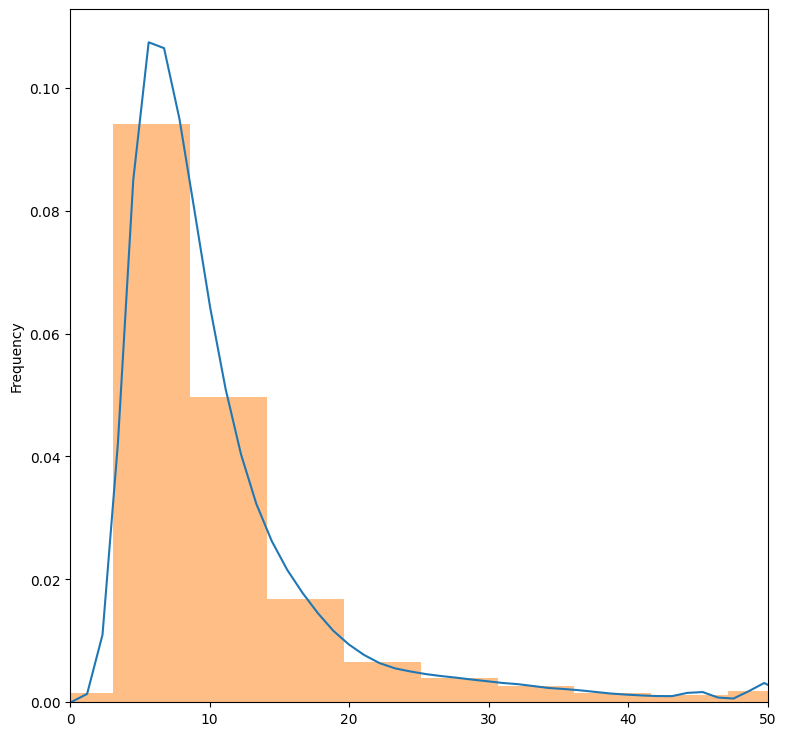

In [ ]:
# armo un primer histograma para ver la distribucion de la Fare Amount
ax = df.fare_amount.plot(kind="density", figsize=(9,9), xlim=(0,50))
df.fare_amount.plot(kind="hist", density=True,bins=100, alpha=0.5, ax=ax)
plt.show()

In [ ]:
# creo columna con ubicacion (la libreria a utilizar luego necesita que la latitutd y longitud esten entre -90 y 90)
df = df[(df.pickup_latitude<90) & (df.dropoff_latitude<90) &
        (df.pickup_latitude>-90) & (df.dropoff_latitude>-90) &
        (df.pickup_longitude<180) & (df.dropoff_longitude<180) &
        (df.pickup_longitude>-180) & (df.dropoff_longitude>-180)]

In [ ]:
# creo una columna que mida las distancias entre pickup y dropoff
df['Distance']=[round(geopy.distance.distance((df.pickup_latitude[i], df.pickup_longitude[i]),(df.dropoff_latitude[i], df.dropoff_longitude[i])).m,2) for i in df.index]

In [ ]:
def hour_segment(hour):
  if 6 <= hour <= 11:
    return 'Morning'
  elif 12 <= hour <= 17:
    return 'Afternoon'
  elif 18 <= hour <= 23:
    return 'Evening'
  else:
    return 'Night'

In [ ]:
# creo columnas de tiempo
df.pickup_datetime=pd.to_datetime(df.pickup_datetime)

df['year'] = df.pickup_datetime.dt.year
df['quarter'] = df.pickup_datetime.dt.quarter
df['month'] = df.pickup_datetime.dt.month
df['weekday'] = df.pickup_datetime.dt.weekday
df['day'] = df.pickup_datetime.dt.day
df['hour'] = df.pickup_datetime.dt.hour

#ademas creo segmentos para la columna hour
df['hour_segment'] = df['hour'].apply(hour_segment)

In [ ]:
# no necesot la fecha exacta para este analisis
#df = df.drop('pickup_datetime', axis=1)

In [ ]:
!pip install reverse-geocode
!pip3 install reverse-geocode

In [ ]:
x = 36.988287
y = 35.272027
coordinates = [(x,y)]

In [ ]:
lats_ini=df['pickup_latitude'].to_list()
lons_ini=df['pickup_longitude'].to_list()
lats_fin=df['dropoff_latitude'].to_list()
lons_fin=df['dropoff_longitude'].to_list()

coords_ini = list(zip(lats_ini,lons_ini))
coords_fin = list(zip(lats_fin,lons_fin))

In [ ]:
import reverse_geocode
reversed_ini = reverse_geocode.search(coords_ini)
reversed_fin = reverse_geocode.search(coords_fin)

In [ ]:
#now i put the reversed data into columns in my df
import reverse_geocode
import pandas as pd

# Assuming 'df' is your DataFrame and 'coords' is the list of coordinates

reversed_locations_ini = reverse_geocode.search(coords_ini)
reversed_locations_fin = reverse_geocode.search(coords_fin)

# Extract relevant information from reversed_locations
countries_ini = [loc['country'] for loc in reversed_locations_ini]
cities_ini = [loc['city'] for loc in reversed_locations_ini]
countries_fin = [loc['country'] for loc in reversed_locations_fin]
cities_fin = [loc['city'] for loc in reversed_locations_fin]


# Add new columns to the DataFrame
df['country_ini'] = countries_ini
df['country_fin'] = countries_fin
df['city_ini'] = cities_ini
df['city_fin'] = cities_fin

In [ ]:
df

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Distance,year,quarter,month,weekday,day,hour,hour_segment,country_ini,country_fin,city_ini,city_fin
0,7.5,2015-05-07 19:52:06+00:00,-73.999817,40.738354,-73.999512,40.723217,1,1681.11,2015,2,5,3,7,19,Evening,United States,United States,Gramercy Park,Chinatown
1,7.7,2009-07-17 20:04:56+00:00,-73.994355,40.728225,-73.994710,40.750325,1,2454.36,2009,3,7,4,17,20,Evening,United States,United States,East Village,Times Square
2,12.9,2009-08-24 21:45:00+00:00,-74.005043,40.740770,-73.962565,40.772647,1,5039.60,2009,3,8,0,24,21,Evening,United States,United States,Gramercy Park,Manhattan
3,5.3,2009-06-26 08:22:21+00:00,-73.976124,40.790844,-73.965316,40.803349,3,1661.44,2009,2,6,4,26,8,Morning,United States,United States,Manhattan,Morningside Heights
4,16.0,2014-08-28 17:47:00+00:00,-73.925023,40.744085,-73.973082,40.761247,5,4483.73,2014,3,8,3,28,17,Afternoon,United States,United States,Sunnyside,Times Square
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
199995,3.0,2012-10-28 10:49:00+00:00,-73.987042,40.739367,-73.986525,40.740297,1,112.13,2012,4,10,6,28,10,Morning,United States,United States,Gramercy Park,Gramercy Park
199996,7.5,2014-03-14 01:09:00+00:00,-73.984722,40.736837,-74.006672,40.739620,1,1879.64,2014,1,3,4,14,1,Night,United States,United States,Gramercy Park,Gramercy Park
199997,30.9,2009-06-29 00:42:00+00:00,-73.986017,40.756487,-73.858957,40.692588,2,12867.92,2009,2,6,0,29,0,Night,United States,United States,Times Square,Woodhaven
199998,14.5,2015-05-20 14:56:25+00:00,-73.997124,40.725452,-73.983215,40.695415,1,3536.55,2015,2,5,2,20,14,Afternoon,United States,United States,Chinatown,Brooklyn Heights


In [ ]:
#veo ciudades y paises
df['city_ini'].value_counts()

,count
city_ini,
Times Square,52466
Manhattan,32705
Gramercy Park,30650
East Village,16529
Hell's Kitchen,16128
...,...
East Haven,1
North Bay Shore,1
Totowa,1


In [ ]:
df['country_ini'].value_counts()

,count
country_ini,
United States,196052
Ghana,3797
French Southern Territories,102
Spain,23
Portugal,6
Canada,3
Peru,2
Colombia,2


In [ ]:
#veo mis valores unicos para cada columna
df.nunique().sort_values()

,0
quarter,4
hour_segment,4
weekday,7
year,7
country_ini,8
passenger_count,8
country_fin,9
month,12
hour,24
day,31


In [ ]:
import folium
import pandas as pd

# i take a random sample of my df to check in the map
df_sample = df.sample(n=1000)


# Create a map centered on the first location
m = folium.Map(location=[df_sample["pickup_latitude"].mean(), df_sample["pickup_longitude"].mean()], zoom_start=2)

# Add markers for each location
for _, row in df_sample.iterrows():
    folium.Marker(
        location=[row["pickup_latitude"], row["pickup_longitude"]],
        popup=row["country_ini"],
    ).add_to(m)

# Show map
m


In [ ]:
import folium
import pandas as pd
from folium.plugins import MarkerCluster, HeatMap

# Me fijo que no traiga valores nulos de latitud y longitud
df = df.dropna(subset=["pickup_latitude", "pickup_longitude"])
df_sample=df.sample(n=10000)
# Creo un mapa con centro en el 0 , 0 y zoom 2
m = folium.Map(location=[0,0], zoom_start=2)

# Que el mapa cubra todos mis valores de maximo y minimo de longitud
bounds = [
    [df_sample["pickup_latitude"].min(), df_sample["pickup_longitude"].min()],
    [df_sample["pickup_latitude"].max(), df_sample["pickup_longitude"].max()]
]
m.fit_bounds(bounds)

# Add a marker cluster
marker_cluster = MarkerCluster().add_to(m)

for _, row in df_sample.iterrows():
    folium.Marker(
        location=[row["pickup_latitude"], row["pickup_longitude"]],
        popup=row["country_ini"],
    ).add_to(marker_cluster)

m


In [ ]:
#vemos que hay valores de pickup en muchas partes del mundo, pero predomina USA para el dataset (nos quedaremos con esos)
# nos quedamos con country inicial USA
df = df[df['country_ini'] == 'United States'].reset_index(drop=True)

In [ ]:
# Hago el mismo mapa pero para lat y lot final
import folium
import pandas as pd
from folium.plugins import MarkerCluster, HeatMap

# Me fijo que no traiga valores nulos de latitud y longitud
df = df.dropna(subset=["dropoff_latitude", "dropoff_longitude"])
df_sample=df.sample(n=10000)
# Creo un mapa con centro en el 0 , 0 y zoom 2
m = folium.Map(location=[0,0], zoom_start=2)

# Que el mapa cubra todos mis valores de maximo y minimo de longitud
bounds = [
    [df_sample["dropoff_latitude"].min(), df_sample["dropoff_longitude"].min()],
    [df_sample["dropoff_latitude"].max(), df_sample["dropoff_longitude"].max()]
]
m.fit_bounds(bounds)

# Add a marker cluster
marker_cluster = MarkerCluster().add_to(m)

for _, row in df_sample.iterrows():
    folium.Marker(
        location=[row["pickup_latitude"], row["pickup_longitude"]],
        popup=row["country_ini"],
    ).add_to(marker_cluster)

m


In [ ]:
#verifico por las dudas cuantos valores estan fuera de usa en dropoff y los sumo por pais y hago un grafico de barras
country_counts = df[df['country_fin'] != 'United States'].groupby('country_fin')['country_fin'].count().reset_index(name='counts')

# hago grafico de barras de country counts con leyenda con plotly
fig = px.bar(country_counts, x='country_fin', y='counts',
             color='country_fin',  # por pais
             title='Paises con dropoff fuera de los estados unidos')

# cambio el layout para mejor vista
fig.update_layout(xaxis_title='Country',
                  yaxis_title='Count',
                  xaxis_tickangle=-45,
                  xaxis={'categoryorder':'total descending'})  # ordeno

fig.show()


In [ ]:
# los quito ya que son muy pocos y no me sirve para la prediccion
df = df[df['country_fin'] == 'United States'].reset_index(drop=True)


<Axes: title={'center': 'fare_amount'}, xlabel='year'>

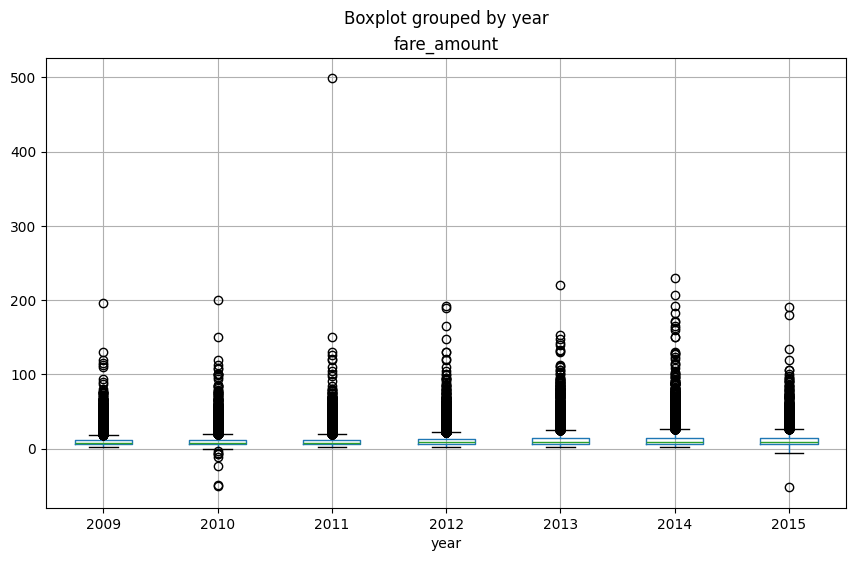

In [ ]:
# hago un boxplot del fare_amount por year
df.boxplot(by='year', column='fare_amount')

In [ ]:
# veo un outlier muy alto y algunos outlier negativos, la fare amount no puede ser negativa
len(df[df['fare_amount'] < 0])

16

In [ ]:
len(df[df['fare_amount'] >300])

1

In [ ]:
df = df[df['fare_amount'] > 0]
df = df[df['fare_amount'] < 300]

<Axes: title={'center': 'fare_amount'}, xlabel='year'>

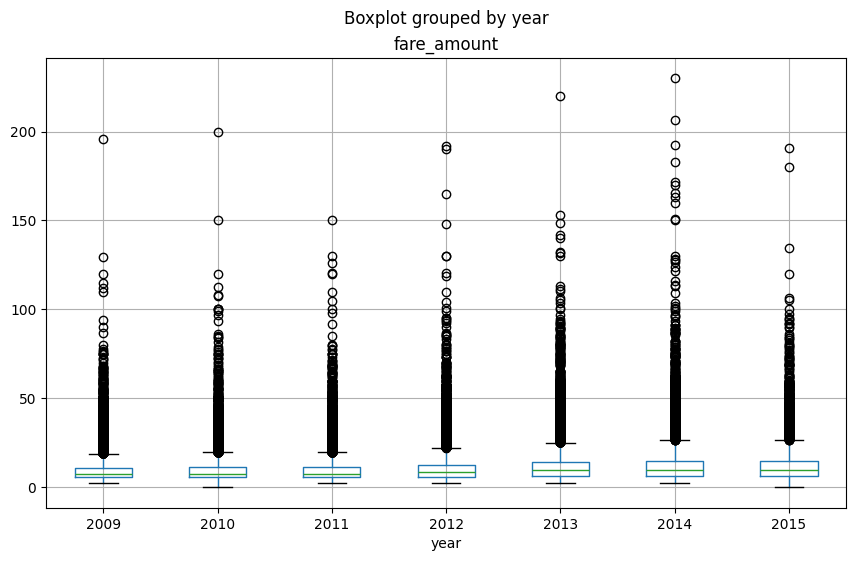

In [ ]:
# vuelvo a ver resultados
df.boxplot(by='year', column='fare_amount')

In [ ]:
df.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Distance,year,quarter,month,weekday,day,hour
count,195837.000000,195837.000000,195837.000000,195837.000000,195837.000000,195837.000000,1.958370e+05,195837.000000,195837.000000,195837.000000,195837.000000,195837.000000,195837.000000
mean,11.341660,-73.975169,40.750855,-73.974159,40.751158,1.684794,3.368667e+03,2011.738982,2.428157,6.283251,3.048173,15.701466,13.490454
std,9.732577,0.060269,0.038090,0.042948,0.037221,1.387656,5.896861e+03,1.859262,1.116954,3.440629,1.947174,8.689038,6.514465
min,0.010000,-89.933333,32.005119,-75.458979,37.533090,0.000000,0.000000e+00,2009.000000,1.000000,1.000000,0.000000,1.000000,0.000000
25%,6.000000,-73.992275,40.736447,-73.991597,40.735322,1.000000,1.256330e+03,2010.000000,1.000000,3.000000,1.000000,8.000000,9.000000
50%,8.500000,-73.982108,40.753307,-73.980536,40.753746,1.000000,2.157310e+03,2012.000000,2.000000,6.000000,3.000000,16.000000,14.000000
75%,12.500000,-73.968355,40.767550,-73.965371,40.768335,2.000000,3.907870e+03,2013.000000,3.000000,9.000000,5.000000,23.000000,19.000000
max,230.000000,-67.370360,42.478467,-69.046738,42.464187,208.000000,1.343523e+06,2015.000000,4.000000,12.000000,6.000000,31.000000,23.000000


In [ ]:
# veo que hay passengers 0
df.passenger_count.value_counts()

,count
passenger_count,
1,135522
2,28844
5,13721
3,8698
6,4184
4,4181
0,686
208,1


In [ ]:
# puedo asumir que si estos eran 1 pasajero
df.loc[df['passenger_count'] == 0, 'passenger_count'] = 1
df.passenger_count.value_counts()

,count
passenger_count,
1,136208
2,28844
5,13721
3,8698
6,4184
4,4181
208,1


In [ ]:
#remuevo la fila que dicce que hubo 208 pasajeros
df = df[df['passenger_count'] != 208]

In [ ]:
df.pivot_table(index='year',columns='passenger_count',values='fare_amount',aggfunc='count')

passenger_count,1,2,3,4,5,6
year,,,,,,
2009,20484,4926,1392,671,2563,133
2010,20301,4590,1344,663,2527,120
2011,21473,4858,1424,684,2497,265
2012,22381,4275,1391,671,2035,824
2013,21434,4178,1347,631,1739,1202
2014,20579,4124,1224,596,1624,1140
2015,9556,1893,576,265,736,500


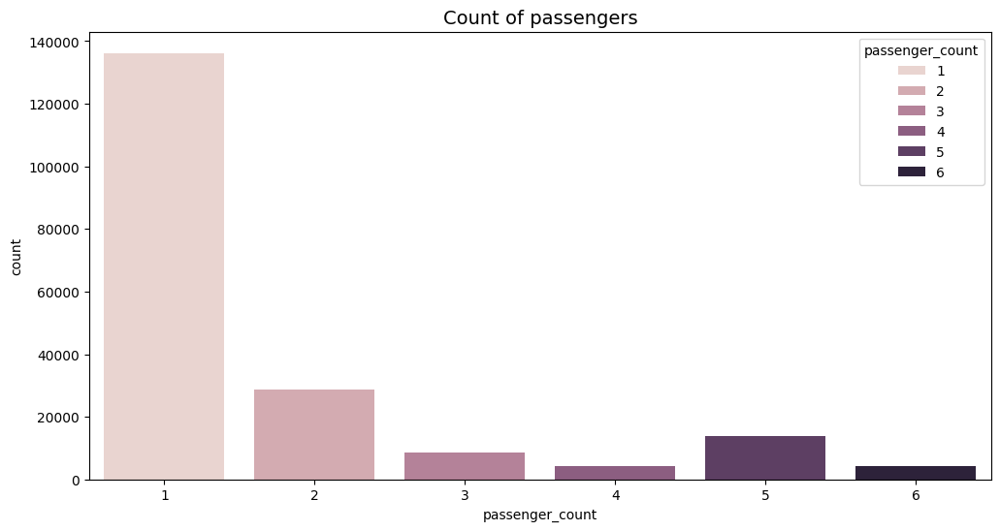

In [ ]:
# Create a figure dimension
plt.figure(figsize=(12, 6))

# CountPlot for count of passengers with legend
sns.countplot(data=df, x='passenger_count', hue='passenger_count')

# Add title
plt.title('Count of passengers', fontsize=14)

# Show plot
plt.show()

<Axes: xlabel='year'>

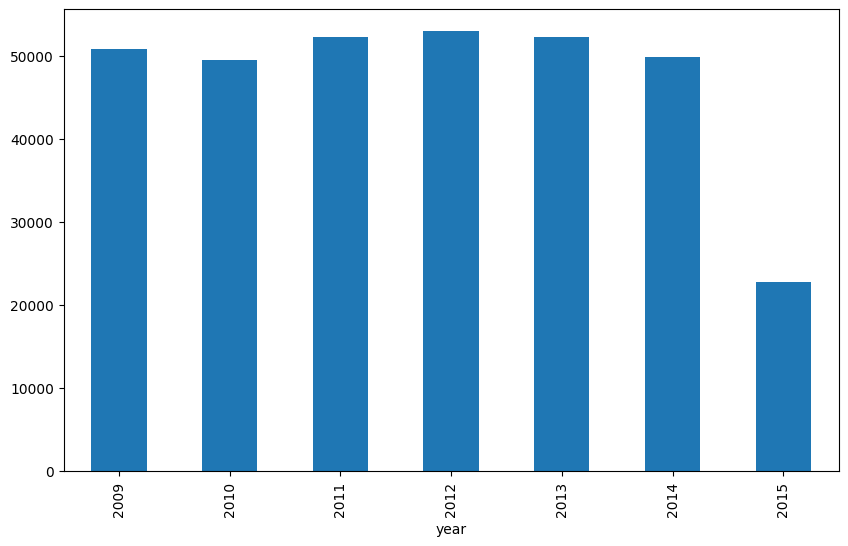

In [ ]:
df.groupby('year')['passenger_count'].sum().plot(kind='bar')

In [ ]:
# veo por mes y año
df.pivot_table(index='year',columns='month',values='fare_amount',aggfunc='count')

month,1,2,3,4,5,6,7,8,9,10,11,12
year,,,,,,,,,,,,
2009,2513.0,2268.0,2668.0,2538.0,2623.0,2504.0,2462.0,2396.0,2459.0,2612.0,2489.0,2637.0
2010,2620.0,1906.0,2337.0,2691.0,2746.0,2557.0,2551.0,2208.0,2424.0,2578.0,2458.0,2469.0
2011,2349.0,2528.0,2789.0,2619.0,2693.0,2745.0,2521.0,2345.0,2580.0,2804.0,2626.0,2602.0
2012,2595.0,2647.0,2826.0,2742.0,2725.0,2526.0,2519.0,2552.0,2615.0,2624.0,2530.0,2676.0
2013,2603.0,2423.0,2741.0,2679.0,2552.0,2562.0,2456.0,2237.0,2551.0,2671.0,2556.0,2500.0
2014,2455.0,2401.0,2702.0,2649.0,2601.0,2412.0,2287.0,2141.0,2342.0,2609.0,2354.0,2334.0
2015,2191.0,2170.0,2325.0,2305.0,2415.0,2120.0,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#el dataset obtenido de kaggle, unicamente tiene datos hasta junio de 2015

In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 195836 entries, 0 to 195856
Data columns (total 19 columns):
 #   Column             Non-Null Count   Dtype              
---  ------             --------------   -----              
 0   fare_amount        195836 non-null  float64            
 1   pickup_datetime    195836 non-null  datetime64[ns, UTC]
 2   pickup_longitude   195836 non-null  float64            
 3   pickup_latitude    195836 non-null  float64            
 4   dropoff_longitude  195836 non-null  float64            
 5   dropoff_latitude   195836 non-null  float64            
 6   passenger_count    195836 non-null  int64              
 7   Distance           195836 non-null  float64            
 8   year               195836 non-null  int32              
 9   quarter            195836 non-null  int32              
 10  month              195836 non-null  int32              
 11  weekday            195836 non-null  int32              
 12  day                195836 non-null 

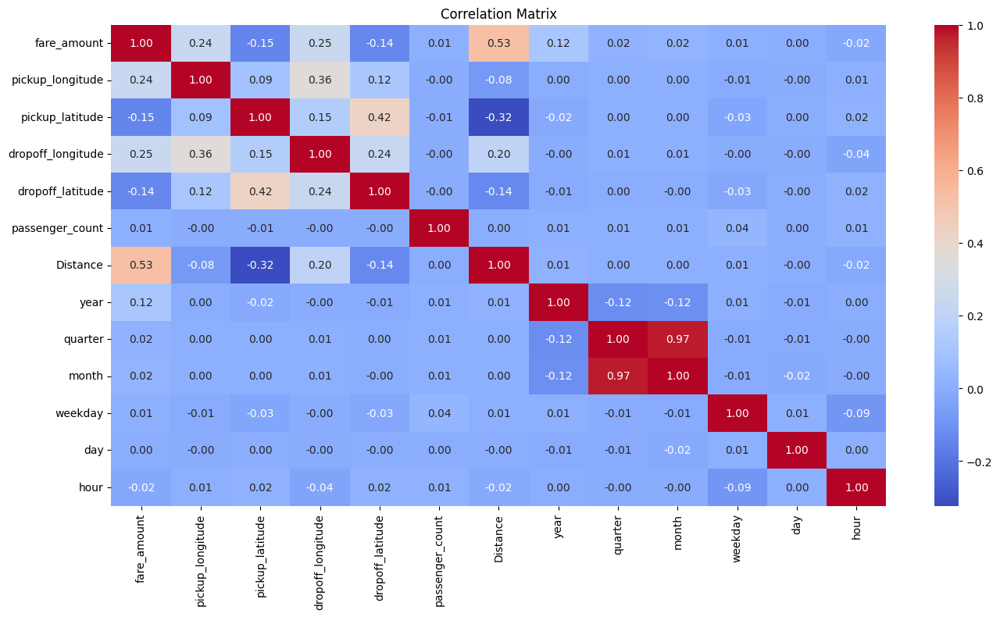

In [ ]:
correlation_matrix = df.corr(numeric_only = True)

# Create a heatmap using seaborn
plt.figure(figsize=(16, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

In [ ]:
# Podemos observar una alta correlación entre la distancia y la longitud.
# Esto se debe a que la distancia en sí misma se calcula utilizando la longitud y la latitud.

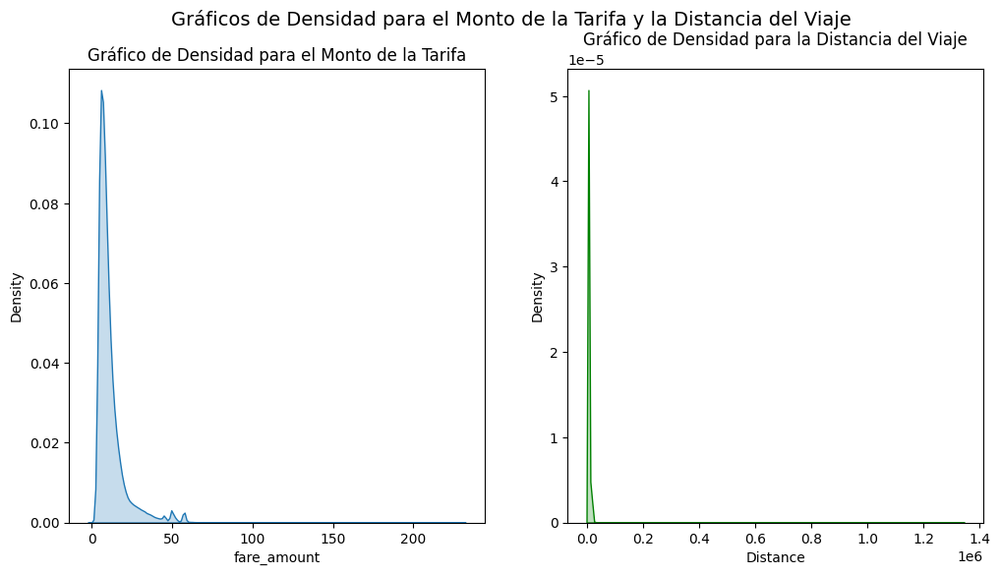

In [ ]:
# Crear una figura con dos subplots
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Gráfico de Densidad para el Monto de la Tarifa
sns.kdeplot(data=df['fare_amount'], ax=axes[0], fill=True)
axes[0].set_title('Gráfico de Densidad para el Monto de la Tarifa')

# Gráfico de Densidad para la Distancia del Viaje
sns.kdeplot(data=df['Distance'], ax=axes[1], fill=True,color='green')
axes[1].set_title('Gráfico de Densidad para la Distancia del Viaje')

# Título general de la figura
plt.suptitle('Gráficos de Densidad para el Monto de la Tarifa y la Distancia del Viaje', fontsize=14)

plt.show()

In [ ]:
pivot_table = df.pivot_table(index='year', values='fare_amount', aggfunc='mean')
pivot_table

,fare_amount
year,
2009,10.006934
2010,10.142799
2011,10.384359
2012,11.189944
2013,12.669699
2014,12.977241
2015,12.960707


In [ ]:
#buscamos mas outlier en la distancia y la fare amount

<Axes: >

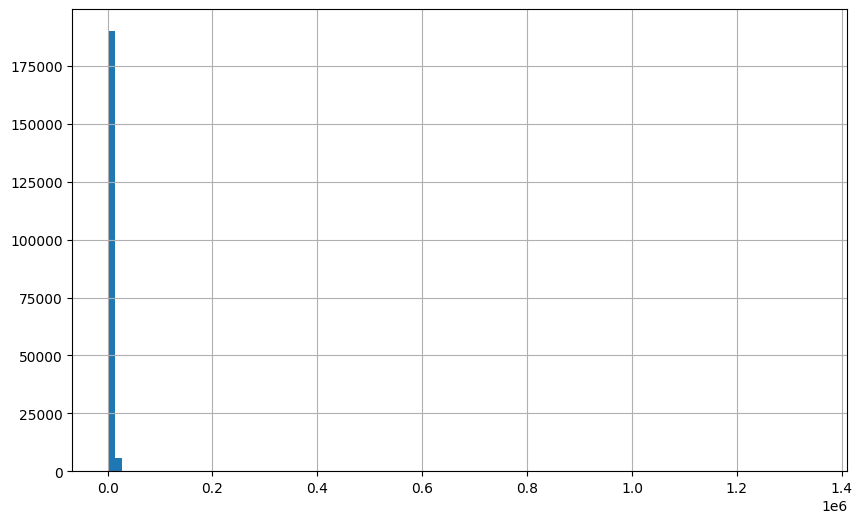

In [ ]:
# histograma de cada una
df["Distance"].hist(bins=100)
#seguro se ve asi debido a algun outlier MUY alto

In [ ]:
df.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Distance,year,quarter,month,weekday,day,hour
count,195836.000000,195836.000000,195836.000000,195836.000000,195836.000000,195836.000000,1.958360e+05,195836.000000,195836.000000,195836.000000,195836.000000,195836.000000,195836.000000
mean,11.341658,-73.975169,40.750855,-73.974159,40.751158,1.687243,3.368684e+03,2011.738991,2.428149,6.283222,3.048183,15.701403,13.490482
std,9.732602,0.060270,0.038090,0.042948,0.037221,1.303816,5.896871e+03,1.859262,1.116952,3.440614,1.947173,8.689016,6.514470
min,0.010000,-89.933333,32.005119,-75.458979,37.533090,1.000000,0.000000e+00,2009.000000,1.000000,1.000000,0.000000,1.000000,0.000000
25%,6.000000,-73.992275,40.736447,-73.991597,40.735322,1.000000,1.256352e+03,2010.000000,1.000000,3.000000,1.000000,8.000000,9.000000
50%,8.500000,-73.982108,40.753307,-73.980536,40.753746,1.000000,2.157320e+03,2012.000000,2.000000,6.000000,3.000000,16.000000,14.000000
75%,12.500000,-73.968356,40.767550,-73.965373,40.768335,2.000000,3.907870e+03,2013.000000,3.000000,9.000000,5.000000,23.000000,19.000000
max,230.000000,-67.370360,42.478467,-69.046738,42.464187,6.000000,1.343523e+06,2015.000000,4.000000,12.000000,6.000000,31.000000,23.000000


In [ ]:
# para remover los outliers, utilizaremos el metodo Hampel X84 visto en clase.
# al ser una distribucion geometrica, utilizare una constante de 4 o 5, para evitar marcar valores extremos válidos como valores atípicos.
from scipy.stats import median_abs_deviation

distance = "Distance"
x = df[distance].dropna()
mediana = x.median()
MAD = median_abs_deviation(x)
k=5

inferior = mediana -  1.4826 * k * MAD
superior = mediana + 1.4826 * 5 * MAD
filtro_outliers_sup = df[distance] > superior
filtro_outliers_inf = df[distance] < inferior

print("Outliers Distancias ", np.round(df[distance][filtro_outliers_inf],3))
print("Outliers Distancias", np.round(df[distance][filtro_outliers_sup],3))
print("Límites con  Hampel X84, theta=5, ",inferior,superior)


Outliers Distancias  Series([], Name: Distance, dtype: float64)
Outliers Distancias 6         11734.67
28        13040.42
32        11355.49
79        15890.26
94        11122.87
            ...   
195829    20312.01
195833    24947.40
195834    20840.02
195839    19502.50
195854    12867.92
Name: Distance, Length: 9115, dtype: float64
Límites con  Hampel X84, theta=5,  -5990.085909999997 10304.725909999997


In [ ]:
# limito las distancias con los limites obtenidos en el paso anterior
df = df[~filtro_outliers_sup]
df = df[~filtro_outliers_inf]

In [ ]:
#hago histograma con plotly
fig = px.histogram(df, x="Distance", nbins=50,color_discrete_sequence=["green"])
fig.show()

In [ ]:
#ahora si la distancia tiene mejor pinta

In [ ]:
# ahora hacemos lo mismo con la fare_amount
fig = px.histogram(df, x="fare_amount", nbins=50)
fig.show()
# se ve asi debido a los outliers

In [ ]:
# como ya hice el metodo de hampel, utilizo otro metodo para eliminar outliers visto en clase
# elimino los valores fuera de los cuantiles

In [ ]:
df = df[df["fare_amount"] < df["fare_amount"].quantile(0.99)]
df = df[df["fare_amount"] > df["fare_amount"].quantile(0.01)]

In [ ]:
fig = px.histogram(df, x="fare_amount", nbins=25)
fig.show()

In [ ]:
df.describe()

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Distance,year,quarter,month,weekday,day,hour
count,181959.000000,181959.000000,181959.000000,181959.000000,181959.000000,181959.000000,181959.000000,181959.000000,181959.000000,181959.000000,181959.000000,181959.000000,181959.000000
mean,9.630991,-73.978970,40.752227,-73.977084,40.752178,1.687550,2695.394108,2011.733984,2.425217,6.273023,3.049231,15.704005,13.529592
std,5.190919,0.032183,0.028160,0.033146,0.030647,1.304643,2017.017460,1.857936,1.117932,3.444119,1.943190,8.684017,6.505831
min,3.400000,-75.387785,39.514527,-75.375315,39.514527,1.000000,0.000000,2009.000000,1.000000,1.000000,0.000000,1.000000,0.000000
25%,6.000000,-73.992502,40.737207,-73.991735,40.736652,1.000000,1252.350000,2010.000000,1.000000,3.000000,1.000000,8.000000,9.000000
50%,8.100000,-73.982373,40.753485,-73.980970,40.753992,1.000000,2075.380000,2012.000000,2.000000,6.000000,3.000000,16.000000,14.000000
75%,11.700000,-73.969790,40.767337,-73.967283,40.768175,2.000000,3526.760000,2013.000000,3.000000,9.000000,5.000000,23.000000,19.000000
max,34.270000,-69.041415,42.478467,-69.046738,42.464187,6.000000,10303.780000,2015.000000,4.000000,12.000000,6.000000,31.000000,23.000000


In [ ]:
df

,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Distance,year,quarter,month,weekday,day,hour,hour_segment,country_ini,country_fin,city_ini,city_fin
0,7.5,2015-05-07 19:52:06+00:00,-73.999817,40.738354,-73.999512,40.723217,1,1681.11,2015,2,5,3,7,19,Evening,United States,United States,Gramercy Park,Chinatown
1,7.7,2009-07-17 20:04:56+00:00,-73.994355,40.728225,-73.994710,40.750325,1,2454.36,2009,3,7,4,17,20,Evening,United States,United States,East Village,Times Square
2,12.9,2009-08-24 21:45:00+00:00,-74.005043,40.740770,-73.962565,40.772647,1,5039.60,2009,3,8,0,24,21,Evening,United States,United States,Gramercy Park,Manhattan
3,5.3,2009-06-26 08:22:21+00:00,-73.976124,40.790844,-73.965316,40.803349,3,1661.44,2009,2,6,4,26,8,Morning,United States,United States,Manhattan,Morningside Heights
4,16.0,2014-08-28 17:47:00+00:00,-73.925023,40.744085,-73.973082,40.761247,5,4483.73,2014,3,8,3,28,17,Afternoon,United States,United States,Sunnyside,Times Square
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195850,9.5,2012-09-29 19:51:27+00:00,-73.987798,40.721210,-73.980960,40.744388,1,2637.91,2012,3,9,5,29,19,Evening,United States,United States,East Village,Gramercy Park
195851,12.0,2014-01-31 14:42:00+00:00,-73.983070,40.760770,-73.972972,40.754177,1,1123.90,2014,1,1,4,31,14,Afternoon,United States,United States,Times Square,Times Square
195853,7.5,2014-03-14 01:09:00+00:00,-73.984722,40.736837,-74.006672,40.739620,1,1879.64,2014,1,3,4,14,1,Night,United States,United States,Gramercy Park,Gramercy Park
195855,14.5,2015-05-20 14:56:25+00:00,-73.997124,40.725452,-73.983215,40.695415,1,3536.55,2015,2,5,2,20,14,Afternoon,United States,United States,Chinatown,Brooklyn Heights


In [ ]:
print('\n\033[1mLimpieza:\033[0m\nPrevio a la limpieza y quite de outliers, el dataset tenia {} muestras.'.format(df_raw.shape[0]))
print('posterior a esto , el dataset ahora tiene {} muestras.'.format(df.shape[0]))


Limpieza:
Previo a la limpieza y quite de outliers, el dataset tenia 200000 muestras.
posterior a esto , el dataset ahora tiene 181959 muestras.


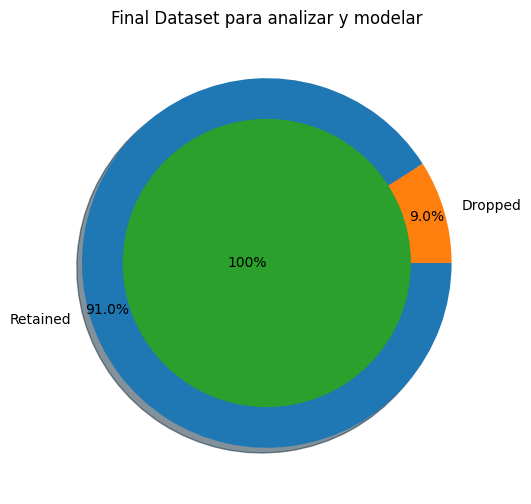


Inference: After the cleanup process, 18041 samples were dropped, while retaining 9.02% of the data.


In [ ]:
df.columns=[i.replace('-','_') for i in df.columns]

plt.title('Final Dataset para analizar y modelar')
plt.pie([df.shape[0], df_raw.shape[0]-df.shape[0]], radius = 1, labels=['Retained','Dropped'], counterclock=False,
        autopct='%1.1f%%', pctdistance=0.9, explode=[0,0], shadow=True)
plt.pie([df.shape[0]], labels=['100%'], labeldistance=-0, radius=0.78)
plt.show()

print(f'\n\033[1mInference:\033[0m After the cleanup process, {df_raw.shape[0]-df.shape[0]} samples were dropped, \
while retaining {round(100 - (df.shape[0]*100/(df_raw.shape[0])),2)}% of the data.')

In [ ]:
# analisis de las variables

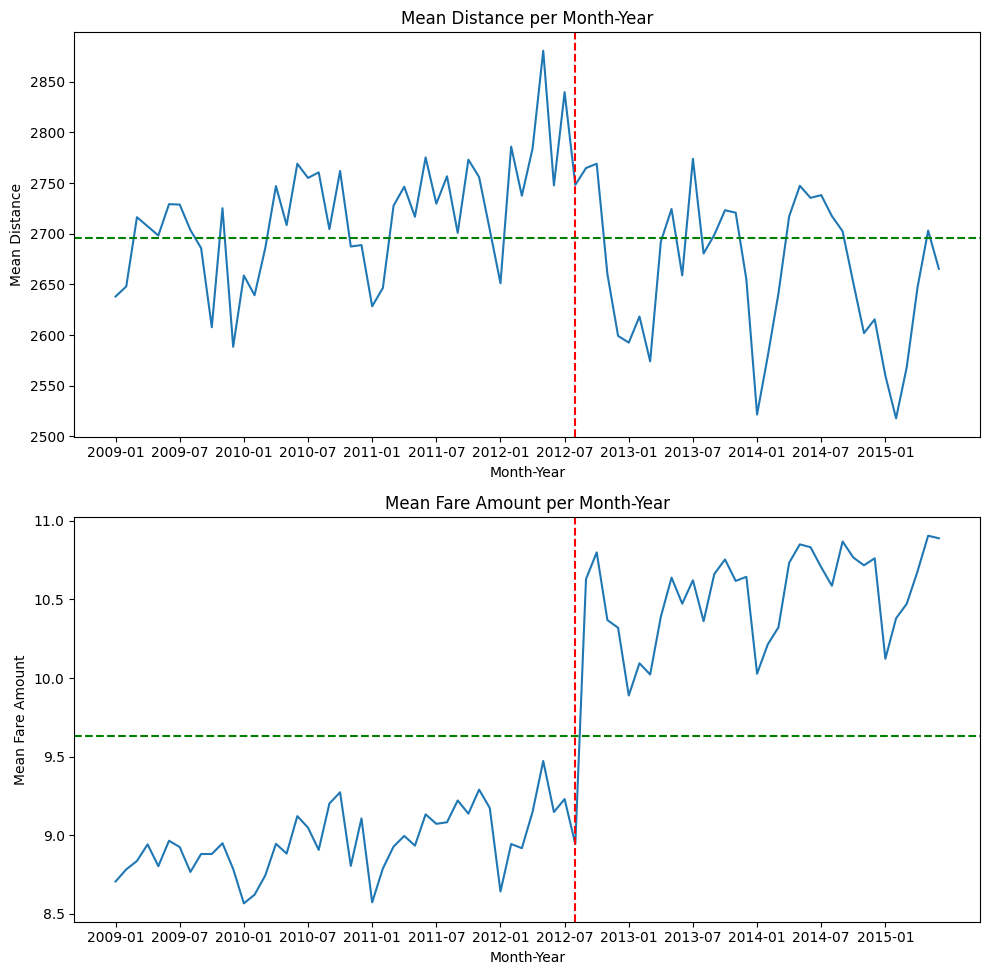

In [ ]:
#Distancia y Fare amount con el pasar del tiempo
fig, axs = plt.subplots(2, 1, figsize=(10, 10))
fig.suptitle('')

# Extract the month and year from the pickup_datetime column
df['month'] = df['pickup_datetime'].dt.month
df['year'] = df['pickup_datetime'].dt.year

# Create a new column combining month and year
df['month_year'] = df['year'].astype(str) + '-' + df['month'].astype(str).str.zfill(2)  # zfill ensures 01, 02, etc.

# Calculate the mean distance for each month-year
mean_distance_per_month_year = df.groupby('month_year')['Distance'].mean()

# Plot the mean distance per month-year
axs[0].plot(mean_distance_per_month_year.index, mean_distance_per_month_year.values)
axs[0].set_xlabel('Month-Year')
axs[0].set_ylabel('Mean Distance')
axs[0].set_title('Mean Distance per Month-Year')


# Calculate the mean fare amount for each month-year
mean_fare_per_month_year = df.groupby('month_year')['fare_amount'].mean()

# Plot the mean fare amount per month-year
axs[1].plot(mean_fare_per_month_year.index, mean_fare_per_month_year.values)
axs[1].set_xlabel('Month-Year')
axs[1].set_ylabel('Mean Fare Amount')
axs[1].set_title('Mean Fare Amount per Month-Year')

n = 6  # Adjust this value to control the frequency of labels
axs[0].set_xticks(axs[0].get_xticks()[::n])
axs[1].set_xticks(axs[1].get_xticks()[::n])

# make vertical line on july 2012
axs[0].axvline(x='2012-08', color='r', linestyle='--')
axs[1].axvline(x='2012-08', color='r', linestyle='--')

#hago 2 lineas horizontales con la media de la distancia y la fare_amount
axs[0].axhline(y=df['Distance'].mean(), color='g', linestyle='--')
axs[1].axhline(y=df['fare_amount'].mean(), color='g', linestyle='--')

plt.tight_layout()
plt.show()

In [ ]:
# se puede ver que hay un subida importante de distancia, haciendo que el precio suba.
# sin embargo, a pesar de luego bajar la distancia a valores mas bajos que la media, la fare sigue por encima de la suya
# posiblemente debido a algun factor extra

<Axes: xlabel='hour_segment'>

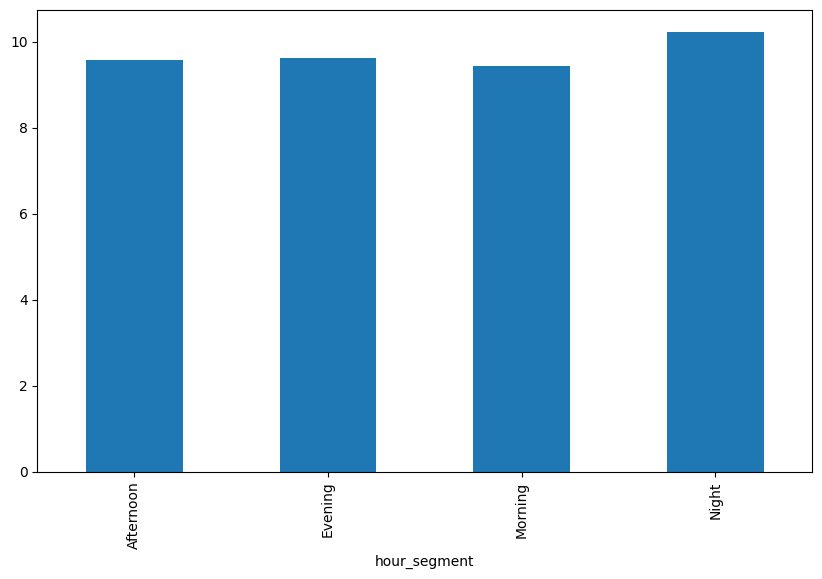

In [ ]:
# veo el promedio de fare amount encuadrado por distancias y con hour segment en bins
df.groupby('hour_segment')['fare_amount'].mean().plot(kind='bar')

In [ ]:
#Pareceria es mas caro viajar a la noche (entre las 23 y las 6). Pero es debido a que viajan mayores distancias?, hagamos lo mismo pero para distancias similares entre 1900 y 2100
df_dist = df[(df['Distance'] >= 1900) & (df['Distance'] <= 2100)]
df_grafico=df_dist.groupby('hour_segment')['fare_amount'].mean()
#hago el grafico con plotly
fig=px.bar(df_grafico,x=df_grafico.index,y=df_grafico.values,color_discrete_sequence=["green"])
fig.show()

In [ ]:
# ahora da algo distinto y mas logico, cuando se trata de distancias mas cercanas a la media. Se ve que es mas caro viajar en horarios Pico

<Axes: xlabel='distance_category'>

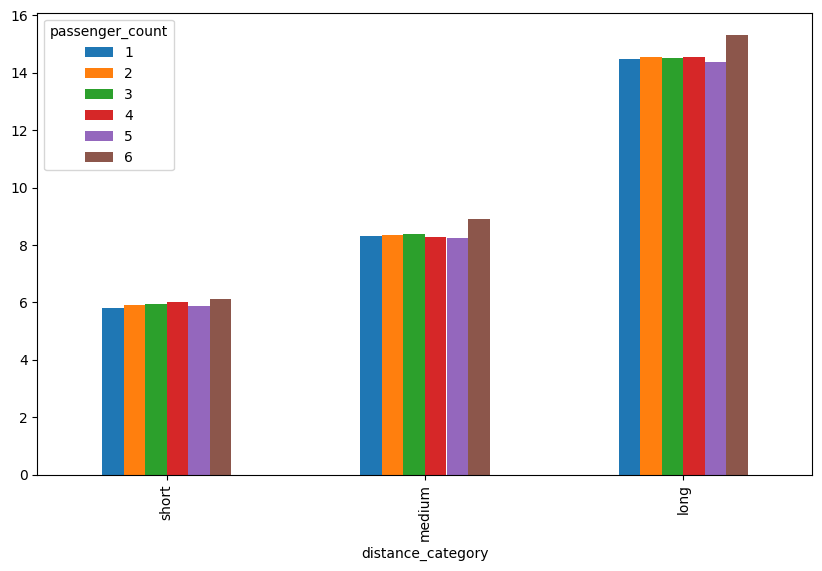

In [ ]:
#veamos si es mucho mas caro viajar con mas pasajeros en distancias cortas y luego medias y luego altas
short_distance_threshold = df['Distance'].quantile(0.33)
medium_distance_threshold = df['Distance'].quantile(0.66)

# Create categorical column 'distance_category'
df['distance_category'] = pd.cut(df['Distance'],
                                 bins=[0, short_distance_threshold, medium_distance_threshold, float('inf')],
                                 labels=['short', 'medium', 'long'])

#ahora hago grafico para ver la fare amount en base a la categoria de distncia y cantidad de pasajeros
df.groupby(['distance_category','passenger_count'])['fare_amount'].mean().unstack().plot(kind='bar')


In [ ]:
# lo que se ve, es que a medida que la distancia aumenta, la diferencia entre viajar con 5 personas o mnos o con 6 se va aumentando.
# en distancias cortas, ni siquiera pareceria ser relevante esa diferencia

<Axes: xlabel='year'>

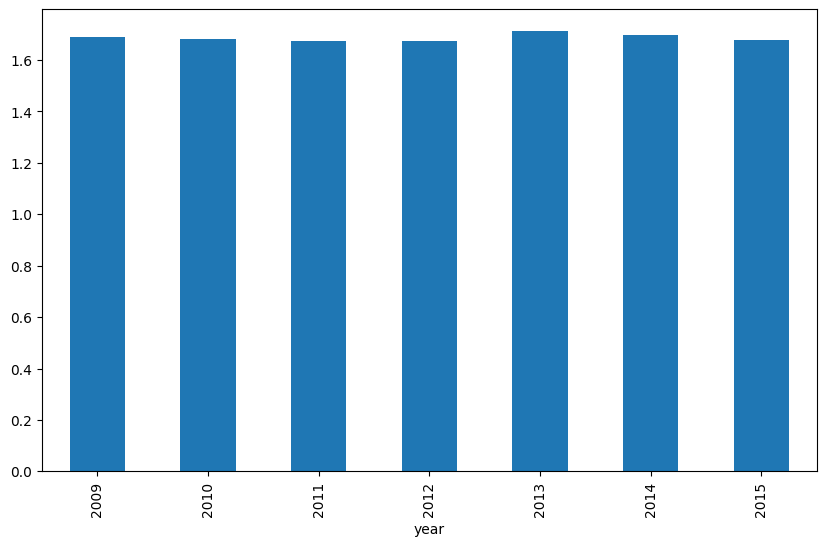

In [ ]:
#veamos si con el pasar del tiempo, la cantidad de pasajeros promedio ha aumentando
df.groupby('year')['passenger_count'].mean().plot(kind='bar')

In [ ]:
# no ha cambiado

In [ ]:
#elimino pickup datetime
df.drop(['pickup_datetime'], axis=1, inplace=True)

In [ ]:
#veo la suma total de las ciudades unicas
#veo cual es el maximo entre estas dos len
max(len(df['city_ini'].value_counts()),len(df['city_fin'].value_counts()))


230

In [ ]:
nu = df.drop(['fare_amount'], axis=1).nunique().sort_values()
nf = []; cf = []; nnf = 0; ncf = 0; #numerical & categorical features

for i in range(df.drop(['fare_amount'], axis=1).shape[1]):
    if nu.values[i]<=230:cf.append(nu.index[i])
    else: nf.append(nu.index[i])

print('\n\033[1mInference:\033[0m The Datset has {} numerical & {} categorical features.'.format(len(nf),len(cf)))


Inference: The Datset has 5 numerical & 14 categorical features.


In [ ]:
nf

['pickup_longitude',
 'dropoff_longitude',
 'pickup_latitude',
 'dropoff_latitude',
 'Distance']

In [ ]:
cf

['country_fin',
 'country_ini',
 'distance_category',
 'hour_segment',
 'quarter',
 'passenger_count',
 'weekday',
 'year',
 'month',
 'hour',
 'day',
 'month_year',
 'city_ini',
 'city_fin']

In [ ]:
# voy a hacer un test de la x2 para ver si dos de mis variables categoricas estan asociadas o no
from scipy.stats import chi2_contingency

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import chi2_contingency

# Ver la tabla de frecuencias observada
tabla_observada = pd.crosstab(df["weekday"], df["hour_segment"])
print("Tabla de Frecuencias Observada:\n", tabla_observada)

# Calcular el test de Chi-cuadrado
chi2, p, dof, tabla_esperada = chi2_contingency(tabla_observada)

# Mostrar resultados
print(f"Valor p: {p}")

# Interpretación del resultado
alpha = 0.05
if p < alpha:
    print("\nRechazamos la hipótesis nula: Existe una asociación significativa")
else:
    print("\nNo se puede rechazar la hipótesis nula: No se encontró asociación significativa")


Tabla de Frecuencias Observada:
 hour_segment  Afternoon  Evening  Morning  Night
weekday                                         
0                  6891     7856     6394   1603
1                  7457     9280     7313   1699
2                  7483     9418     7422   2089
3                  7340    10057     7487   2436
4                  7535    10228     7098   3295
5                  7934     9800     4474   5582
6                  7149     6539     3840   6260
Valor p: 0.0

Rechazamos la hipótesis nula: Existe una asociación significativa


In [ ]:
#ahora veamos para el quarter y la ciudad

In [ ]:
import pandas as pd
import numpy as np
from scipy.stats import chi2_contingency

# Ver la tabla de frecuencias observada
tabla_observada = pd.crosstab(df["year"], df["hour_segment"])
print("Tabla de Frecuencias Observada:\n", tabla_observada)

# Calcular el test de Chi-cuadrado
chi2, p, dof, tabla_esperada = chi2_contingency(tabla_observada)

# Mostrar resultados
print(f"Valor p: {p}")

# Interpretación del resultado
alpha = 0.05
if p < alpha:
    print("\nRechazamos la hipótesis nula: Existe una asociación significativa")
else:
    print("\nNo se puede rechazar la hipótesis nula: No se encontró asociación significativa")


Tabla de Frecuencias Observada:
 hour_segment  Afternoon  Evening  Morning  Night
year                                            
2009               8085     9649     6782   3551
2010               7964     9467     6673   3423
2011               8205    10073     7078   3757
2012               8363    10266     7094   3659
2013               7959     9987     6770   3563
2014               7663     9406     6551   3468
2015               3550     4330     3080   1543
Valor p: 0.49410795877805525

No se puede rechazar la hipótesis nula: No se encontró asociación significativa


In [ ]:
#Vemos que el el segmento de hora y el year no tienen una asociacion significativa, mientras que el dia de la semana con el horario si la tiene
# logico, los dias cercanos al fin de semana influiran en el horario de los pedidos.

In [ ]:
#Insights obtenidos


Insights obtenidos
1. El precio ha aumentado con el tiempo, viendose un incremento importante en agosto de 2012
2. Con el pasar del tiempo, las distancias han bajado considerablemente
3. Para hacer viajes muy ceranos al promedio, es mas caro viajar en horarios mañana y tarde ( de 6 a 11 y de 12 a 17)
4. Viajar con diferente cantidad de pasajeros no influye en la tarifa. Sin embargo, cuando hay 6 pasajeros viajar distancias mas largas empieza a mostrar una diferencia con respecto a viajes con menor cantidad de viajeros.
5. La cantidad de pasajeros se ha mantenido estable con el tiempo
6. y como era evidente, la distancia influye altamente en el precio de la tarifa
7. El segmento de hora, tiene una asociacion significativa con el dia de la semana pero no con el year

In [ ]:
# Analisis de correlaciones de columnas a utilizar
#elimino columnas que no utilizare como country y distance category
df.drop(['country_ini','country_fin','distance_category'], axis=1, inplace=True)

In [ ]:
#al usar hour como categoria, elimino la hora
df.drop(['hour'], axis=1, inplace=True)

In [ ]:
#al tener month y el year, elmino month year
df.drop(['month_year'], axis=1, inplace=True)

In [ ]:
df

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count,Distance,year,quarter,month,weekday,day,hour_segment,city_ini,city_fin
0,7.5,-73.999817,40.738354,-73.999512,40.723217,1,1681.11,2015,2,5,3,7,Evening,Gramercy Park,Chinatown
1,7.7,-73.994355,40.728225,-73.994710,40.750325,1,2454.36,2009,3,7,4,17,Evening,East Village,Times Square
2,12.9,-74.005043,40.740770,-73.962565,40.772647,1,5039.60,2009,3,8,0,24,Evening,Gramercy Park,Manhattan
3,5.3,-73.976124,40.790844,-73.965316,40.803349,3,1661.44,2009,2,6,4,26,Morning,Manhattan,Morningside Heights
4,16.0,-73.925023,40.744085,-73.973082,40.761247,5,4483.73,2014,3,8,3,28,Afternoon,Sunnyside,Times Square
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195850,9.5,-73.987798,40.721210,-73.980960,40.744388,1,2637.91,2012,3,9,5,29,Evening,East Village,Gramercy Park
195851,12.0,-73.983070,40.760770,-73.972972,40.754177,1,1123.90,2014,1,1,4,31,Afternoon,Times Square,Times Square
195853,7.5,-73.984722,40.736837,-74.006672,40.739620,1,1879.64,2014,1,3,4,14,Night,Gramercy Park,Gramercy Park
195855,14.5,-73.997124,40.725452,-73.983215,40.695415,1,3536.55,2015,2,5,2,20,Afternoon,Chinatown,Brooklyn Heights


In [ ]:
#veo correlaciones entre las columnas
correlation_matrix = df.corr(numeric_only = True)

fig = px.imshow(correlation_matrix,
                x=correlation_matrix.columns,
                y=correlation_matrix.columns,
                color_continuous_scale='RdBu_r',
                zmin=-1, zmax=1,
                )
fig.update_layout(title='Correlation Matrix',
                  height=800,  # Adjust height as needed
                  width=800   # Adjust width as needed
                  )
fig.show()

In [ ]:
#vuelvo a ver mis variables categoricas y numericas
nu = df.drop(['fare_amount'], axis=1).nunique().sort_values()
nf = []; cf = []; nnf = 0; ncf = 0;

for i in range(df.drop(['fare_amount'], axis=1).shape[1]):
    if nu.values[i]<=230:cf.append(nu.index[i])
    else: nf.append(nu.index[i])

print('\n\033[1mInference:\033[0m The Datset has {} numerical & {} categorical features.'.format(len(nf),len(cf)))


Inference: The Datset has 5 numerical & 9 categorical features.


In [ ]:
print ('Numerical Features: \n', nf)
print ('\nCategorical Features: \n', cf)

Numerical Features: 
 ['pickup_longitude', 'dropoff_longitude', 'pickup_latitude', 'dropoff_latitude', 'Distance']

Categorical Features: 
 ['quarter', 'hour_segment', 'passenger_count', 'year', 'weekday', 'month', 'day', 'city_ini', 'city_fin']


In [ ]:
#perfecto, ahora hago el get dummies para las columnas categoricas

In [ ]:
#hago un get dummies para las columnas categoricas
df = pd.get_dummies(df, columns=cf, drop_first=True)

In [ ]:
df

,fare_amount,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,Distance,quarter_2,quarter_3,quarter_4,hour_segment_Evening,...,city_fin_Weehawken,city_fin_West New York,city_fin_White Horse,city_fin_Whitestone,city_fin_Williamsburg,city_fin_Wood-Ridge,city_fin_Woodhaven,city_fin_Woodlawn,city_fin_Woodside,city_fin_World Trade Center
0,7.5,-73.999817,40.738354,-73.999512,40.723217,1681.11,True,False,False,True,...,False,False,False,False,False,False,False,False,False,False
1,7.7,-73.994355,40.728225,-73.994710,40.750325,2454.36,False,True,False,True,...,False,False,False,False,False,False,False,False,False,False
2,12.9,-74.005043,40.740770,-73.962565,40.772647,5039.60,False,True,False,True,...,False,False,False,False,False,False,False,False,False,False
3,5.3,-73.976124,40.790844,-73.965316,40.803349,1661.44,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False
4,16.0,-73.925023,40.744085,-73.973082,40.761247,4483.73,False,True,False,False,...,False,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195850,9.5,-73.987798,40.721210,-73.980960,40.744388,2637.91,False,True,False,True,...,False,False,False,False,False,False,False,False,False,False
195851,12.0,-73.983070,40.760770,-73.972972,40.754177,1123.90,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
195853,7.5,-73.984722,40.736837,-74.006672,40.739620,1879.64,False,False,False,False,...,False,False,False,False,False,False,False,False,False,False
195855,14.5,-73.997124,40.725452,-73.983215,40.695415,3536.55,True,False,False,False,...,False,False,False,False,False,False,False,False,False,False


In [ ]:
#habiendo hecho el get dummies, deje todo listo para hacer un modelo predictivo (No pedido pero se hara en otra asignatura seguramente)

In [ ]:
#hago una recta de regresion para la fare amount con la distancia , al haber visto que es la que mas correlaciona con esta

In [ ]:
# Solución
#Muestro los coeficientes de regresion
df2 = df[['fare_amount', 'Distance']]
df2

,fare_amount,Distance
0,7.5,1681.11
1,7.7,2454.36
2,12.9,5039.60
3,5.3,1661.44
4,16.0,4483.73
...,...,...
195850,9.5,2637.91
195851,12.0,1123.90
195853,7.5,1879.64
195855,14.5,3536.55


In [ ]:
import statsmodels.api as sm

In [ ]:
X = sm.add_constant(df2[['Distance']])
y = df2['fare_amount']
model_fare = sm.OLS(y, X).fit()  # aquí se genera el modelo

### Mostramos los parámetros
alpha, coef_du = model_fare.params
print(f"fare_amount = {coef_du:.3f} x Distance + {alpha:.3f}")

fare_amount = 0.002 x SCI + 3.807


In [ ]:
print(model_fare.summary())

                            OLS Regression Results                            
Dep. Variable:            fare_amount   R-squared:                       0.705
Model:                            OLS   Adj. R-squared:                  0.705
Method:                 Least Squares   F-statistic:                 4.344e+05
Date:                Thu, 21 Nov 2024   Prob (F-statistic):               0.00
Time:                        10:55:03   Log-Likelihood:            -4.4686e+05
No. Observations:              181959   AIC:                         8.937e+05
Df Residuals:                  181957   BIC:                         8.937e+05
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          3.8075      0.011    345.013      0.0

In [ ]:
# un r2 de 0,7 no es SUMAMENTE bueno, pero logra dar un primer pantallaso a la prediccion de la tarifa

In [ ]:
from sklearn.model_selection import train_test_split
from tqdm import tqdm
from sklearn.metrics import mean_absolute_error, mean_squared_error
X = df2[['Distance']]
y = df2['fare_amount']

veces = 2000
bias = []
mae = []
rmse = []
for _ in tqdm(range(veces)):

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.40) # ojo, sin random_state

    X_train_sm = sm.add_constant(X_train)
    m = sm.OLS(y_train, X_train_sm).fit()  # aquí se genera el modelo

    X_test_sm = sm.add_constant(X_test)
    y_pred = m.predict(X_test_sm)
    bias.append(np.mean(y_pred - y_test))
    mae.append(mean_absolute_error(y_test, y_pred))
    rmse.append(np.sqrt(mean_squared_error(y_test, y_pred)))

errores = pd.DataFrame({"bias":bias,"mae":mae,"rmse":rmse})

100%|██████████| 2000/2000 [01:59<00:00, 16.69it/s]


In [ ]:
errores.mean()

,0
bias,-0.000169
mae,1.903150
rmse,2.820543


In [ ]:
predictions = m.get_prediction(X_test_sm)
pred_summary = predictions.summary_frame(alpha=0.05)  # Intervalo de confianza al 95%

# Extraer los límites inferior y superior del intervalo de confianza
y_pred = pred_summary['mean']
conf_int_lower = pred_summary['obs_ci_lower']  # Límite inferior del intervalo de predicción
conf_int_upper = pred_summary['obs_ci_upper']  # Límite superior del intervalo de predicción

print("Predicciones:", y_pred.mean())
print("Intervalo de confianza inferior:", conf_int_lower.mean())
print("Intervalo de confianza superior:", conf_int_upper.mean())

Predicciones: 9.609581852583363
Intervalo de confianza inferior: 4.068461777969663
Intervalo de confianza superior: 15.150701927197067


In [ ]:
#vemos que la prediccion no es ALTAMENTE precisa, pero es debido a que hacemos una regresion linea.
# con el dataset ya armado y con las columnas que tenemos, se podria hacer un modelo predictivo para tener mayor precision